In [32]:
import warnings
warnings.filterwarnings('ignore')
import numpy as np
import pandas as pd
from google.colab import files

In [1]:
!nvidia-smi

Sun May 30 15:41:37 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.19.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   66C    P8    12W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

**Import the datasets**

In [25]:
train=pd.read_csv('/content/drive/MyDrive/Data/Jobathon2/train_s3TEQDk.csv',index_col=0)
test=pd.read_csv('/content/drive/MyDrive/Data/Jobathon2/test_mSzZ8RL.csv',index_col=0)
sub=pd.read_csv('/content/drive/MyDrive/Data/Jobathon2/sample_submission_eyYijxG.csv')

**Perform Descriptive Statistics**

In [41]:
#Check the train set variables
print(train.dtypes)
print(train.shape)
print(train.describe(include='all'))

Gender                 object
Age                     int64
Region_Code            object
Occupation             object
Channel_Code           object
Vintage                 int64
Credit_Product         object
Avg_Account_Balance     int64
Is_Active              object
Is_Lead                 int64
dtype: object
(245725, 10)
        Gender            Age  ... Is_Active        Is_Lead
count   245725  245725.000000  ...    245725  245725.000000
unique       2            NaN  ...         2            NaN
top       Male            NaN  ...        No            NaN
freq    134197            NaN  ...    150290            NaN
mean       NaN      43.856307  ...       NaN       0.237208
std        NaN      14.828672  ...       NaN       0.425372
min        NaN      23.000000  ...       NaN       0.000000
25%        NaN      30.000000  ...       NaN       0.000000
50%        NaN      43.000000  ...       NaN       0.000000
75%        NaN      54.000000  ...       NaN       0.000000
max        Na

Thr variables in the training data consists of both qualitative as well as quantitative variables. For the qualitative variables, the unique values are 2,35,4,4,2,2 respectively for Gender, Region_Code, Occupation, Channel_Code, Credit_Product and Is_Active. For the quantitative variable Age the mean and the median are equal thus innitially seggesting that there are no outliers. Also for the variable Vintage the mean and the median are almost same while the variable Avg_Account_Balance is a matter of concern as it seems like it contains outliers. Further we'll visialize these variables to get a broader picture.

In [42]:
#Check the test set variables
print(test.dtypes)
print(test.shape)

Gender                 object
Age                     int64
Region_Code            object
Occupation             object
Channel_Code           object
Vintage                 int64
Credit_Product         object
Avg_Account_Balance     int64
Is_Active              object
dtype: object
(105312, 9)


In [76]:
#Check if there are missing values in the target variable if true then drop them
print(train['Is_Lead'].isna().sum()/len(train))
train=train.dropna(axis=0,subset=['Is_Lead'])

0.0


There are no missing values in the dependent variable.

**Divide the train set in X and y**

In [3]:
y=train[['Is_Lead']]
X=train.drop(['Is_Lead'],axis=1)
print(X.shape)

(245725, 9)


In [78]:
print(type(y))

<class 'pandas.core.frame.DataFrame'>


In [79]:
#Check if the column names of train and test set are equal or not
train_cols=X.columns
#train_cols=train.columns
test_cols=test.columns
common_cols=train_cols.intersection(test_cols)
diff_cols=train_cols.difference(test_cols)
print(diff_cols)

Index([], dtype='object')


Clearly the column names are same for both the datasets except for Is_Lead column.

***Let us perform EDA on the dataset***

In [4]:
#Let us define few functions for visualization

import seaborn as sns
import matplotlib.pyplot as plt

def boxplot(df):
    plt.figure(figsize=(10,6))
    plt.title('Boxplot')
    sns.boxplot(df)
    plt.show()

def histogram(df):
    plt.figure(figsize=(10,6))
    sns.displot(df,kde=True)
    plt.title('Histogram')
    sns.despine()
    plt.show

def countplot(df):
    plt.figure(figsize=(10,6))
    sns.countplot(df,palette='spring')
    plt.title('Countplot')
    plt.show()
    

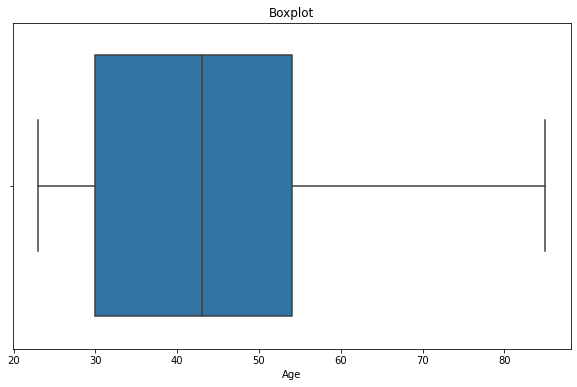

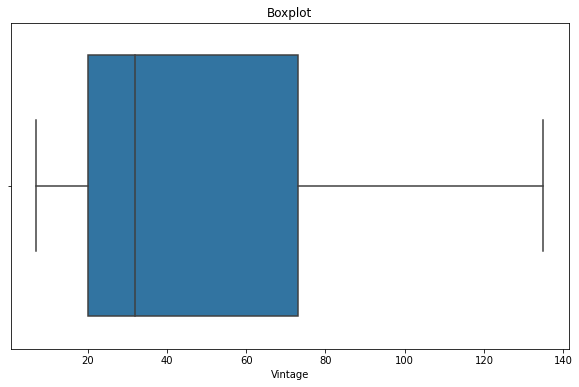

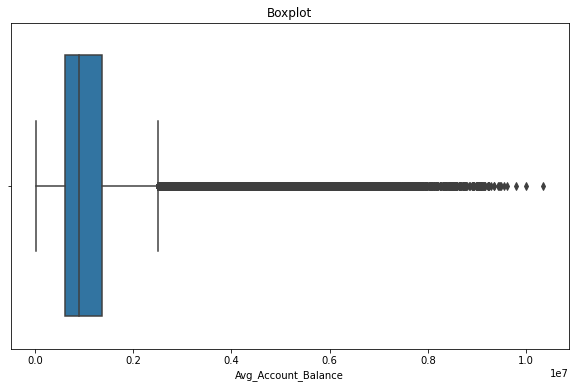

In [5]:
#Visualize the numeric variables (Boxplot)
num_col=train.select_dtypes(include=[np.number]).columns
num_cols=[n for n in num_col if n not in ['Is_Lead']]
 
for n in num_cols:
    boxplot(train[n])

The Avg_Account_Balance numeric variable has outliers. We'll find out a way to deal with this later. Let us plot the distributions of these variables.

<Figure size 720x432 with 0 Axes>

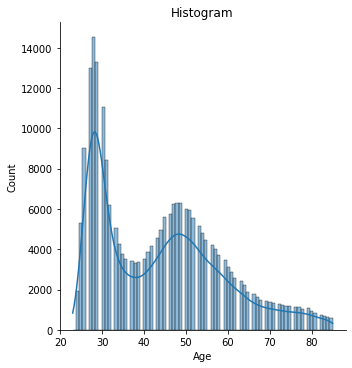

<Figure size 720x432 with 0 Axes>

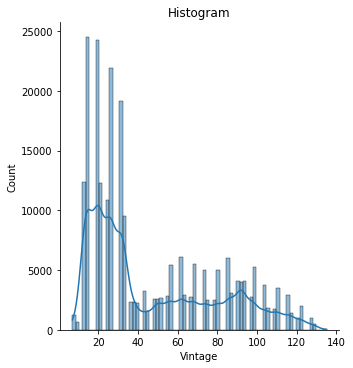

<Figure size 720x432 with 0 Axes>

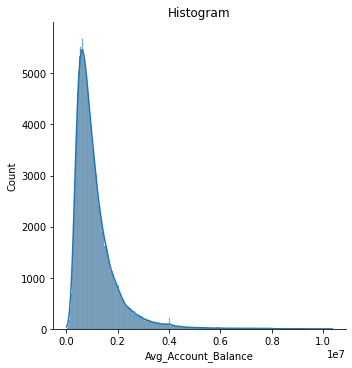

In [82]:
#Distribution of the numeric variables
for n in num_cols:
    histogram(train[n])

None of these variables are symmetric in nature. We'll apply preprocessing later. Avg_Account_Balance a long lest tail suggesting these are basically outliers. However in boosting algorithms outliers is not at all a matter of concern.

In [ ]:
#Drop outliers
#index=X[X['Avg_Account_Balance'] > 4000000].index
#X.drop(index,inplace=True)
#print(X.shape)

(219669, 9)


In [ ]:
#y.drop(index,inplace=True)
#print(y.shape)

(219669, 1)


/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4174: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


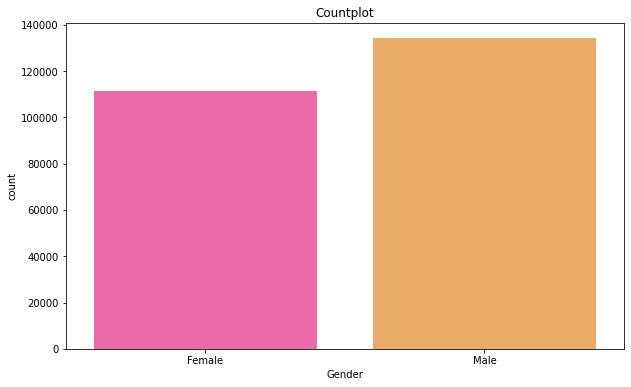

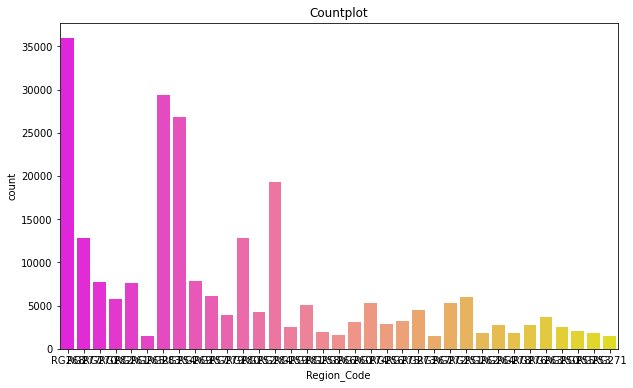

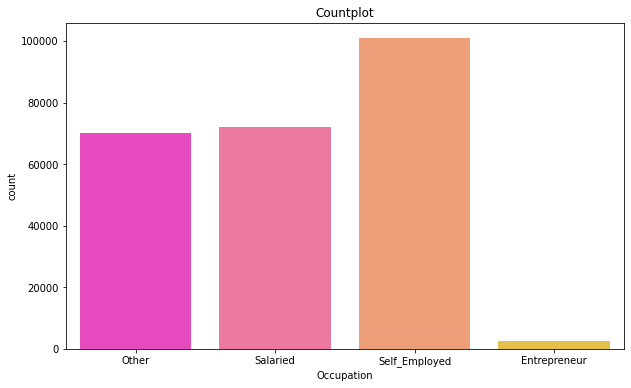

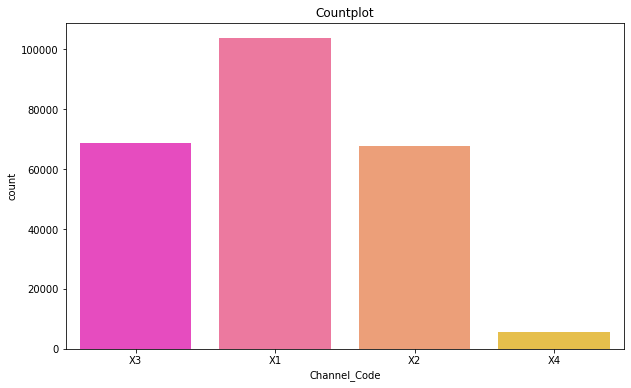

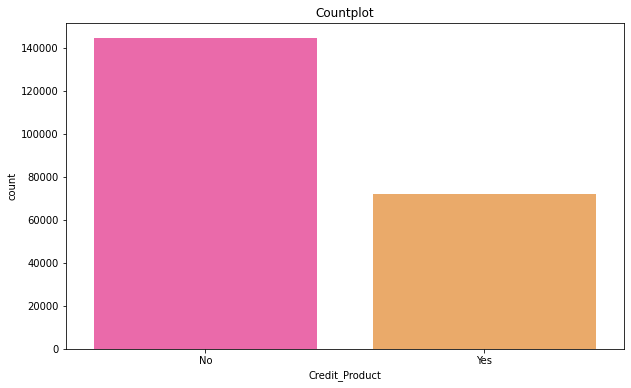

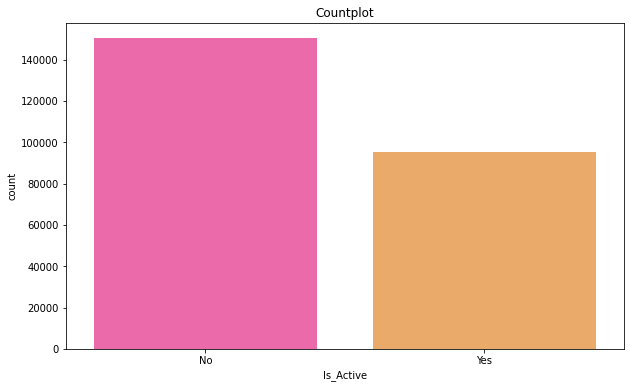

In [6]:
#Count plot of the categorical variables
cat_col=train.select_dtypes(exclude=[np.number]).columns
cat_cols=[ c for c in cat_col]

for c in cat_cols:
    countplot(train[c])

The number of males is slightly more than the number of females. Entrepreneur are very low in numbers. Most of the people are self employed. X1 ha the highest Channel_Code and X4 the least.Majority of the customers have no active Credit_Product. Finally most of the customers are not Active for the last 3 months. 

***Understanding the dataset extensively***

In [ ]:
#Median age of the Leads
train.pivot_table(values='Age',index='Is_Lead',aggfunc=np.median)

,Age
Is_Lead,
0,38
1,49


In [ ]:
#Mean age of the leads
train.pivot_table(values='Age',index='Is_Lead')

,Age
Is_Lead,
0,41.947662
1,49.993944


In [ ]:
train.groupby(['Is_Lead','Gender'])['Age'].mean()

Is_Lead  Gender
0        Female    39.604461
         Male      44.058217
1        Female    48.338956
         Male      51.049968
Name: Age, dtype: float64

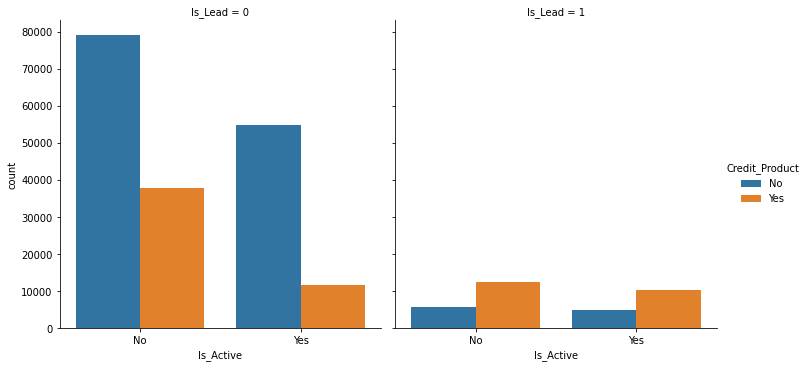

In [ ]:
sns.catplot(x='Is_Active',hue='Credit_Product',col='Is_Lead',data=train,kind='count')

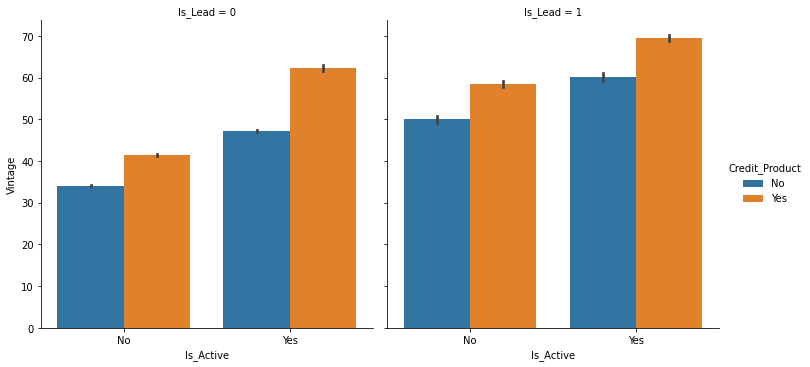

In [ ]:
sns.catplot(x='Is_Active',y='Vintage',hue='Credit_Product',col='Is_Lead',data=train,kind='bar')

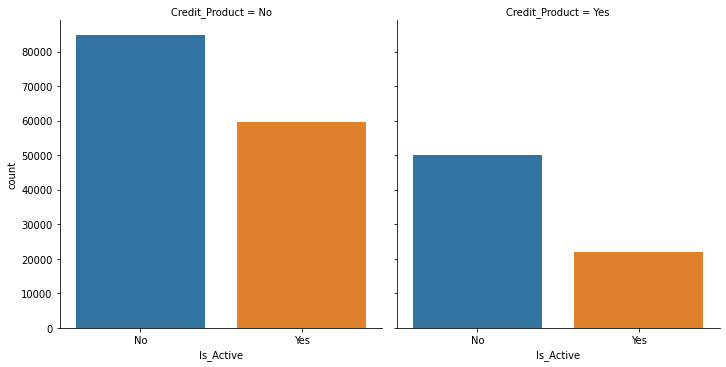

In [ ]:
sns.catplot(x='Is_Active',col='Credit_Product',data=train,kind='count')

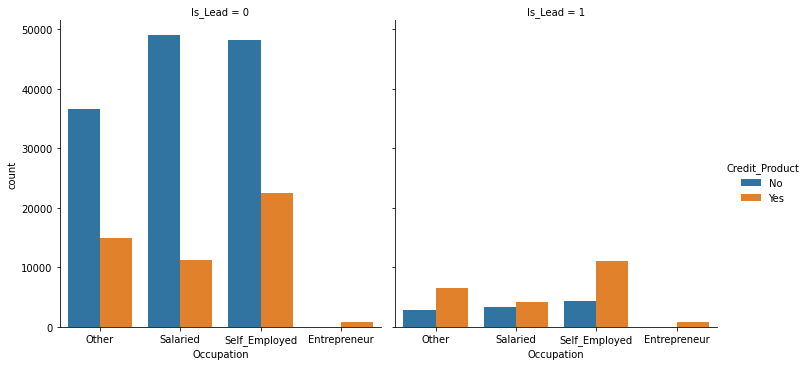

In [ ]:
sns.catplot(x='Occupation',hue='Credit_Product',col='Is_Lead',data=train,kind='count')

***Check for missing values***

In [115]:
print(train.select_dtypes(include=[np.number]).isna().sum()/len(train))
print(train.select_dtypes(exclude=[np.number]).isna().sum()/len(train))
print('************************************************')
print(test.select_dtypes(include=[np.number]).isna().sum()/len(test))
print(test.select_dtypes(exclude=[np.number]).isna().sum()/len(test))

Age                    0.0
Vintage                0.0
Avg_Account_Balance    0.0
Is_Lead                0.0
dtype: float64
Gender            0.000000
Region_Code       0.000000
Occupation        0.000000
Channel_Code      0.000000
Credit_Product    0.119341
Is_Active         0.000000
dtype: float64
************************************************
Age                    0.0
Vintage                0.0
Avg_Account_Balance    0.0
dtype: float64
Gender            0.000000
Region_Code       0.000000
Occupation        0.000000
Channel_Code      0.000000
Credit_Product    0.118904
Is_Active         0.000000
dtype: float64


The quantitative variable Credit_Product contains 0.11 % missing values in the test set and 0.11 % missing values in the training set. We'll impute them later.

***Check whether the dependent variable is balanced or not***

0    187437
1     58288
Name: Is_Lead, dtype: int64


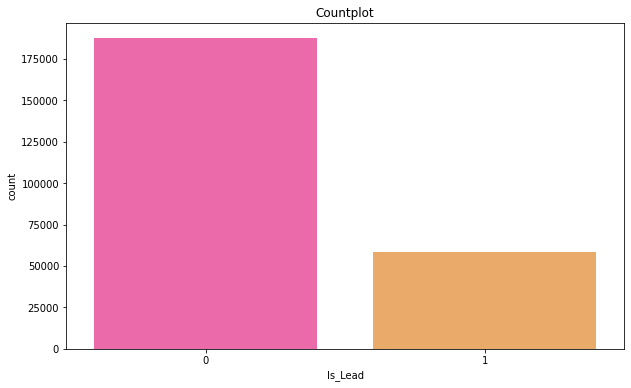

In [7]:
print(train['Is_Lead'].value_counts())
countplot(train['Is_Lead'])

The dataset is highly imbalanced. We can use SMOTE for undersampling or oversampling. . One thing to remember is to stratify while performing train test split. Here the proportion is 3.21.

***Perform Train Test split***

In [8]:
from sklearn.model_selection import train_test_split
X_train,X_valid,y_train,y_valid=train_test_split(X,y,test_size=.25,stratify=y,random_state=99)

In [9]:
print(X_train.shape, X_valid.shape)
print(y_train.value_counts())

(184293, 9) (61432, 9)
Is_Lead
0          140577
1           43716
dtype: int64


Clearly due to stratification the imbalanced nature of the dataset is maintained here. The proportion is 3.21 which is maintained.

***Apply preprocessing***

In [50]:
#Concat the two datasets
#test["Is_Lead"] = -1
#data = pd.concat([train, test]).reset_index(drop=True)

In [10]:
#Apply preprocessing to the numeric variables

from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import KBinsDiscretizer
from scipy import stats

#Box-Cox transformation
#fitted_data, fitted_lambda = stats.boxcox(np.abs(X_train['Vintage']))
#X_train['Vintage_box'] = fitted_data
#fitted_data, fitted_lambda = stats.boxcox(np.abs(X_valid['Vintage']))
#X_valid['Vintage_box'] = fitted_data
#fitted_data, fitted_lambda = stats.boxcox(np.abs(test['Vintage']))
#test['Vintage_box'] = fitted_data

#Log transformation
for n in num_cols:
  X_train[n+'_log']=np.log(X_train[[n]])
  X_valid[n+'_log']=np.log(X_valid[[n]])
  test[n+'_log']=np.log(test[[n]])

#KB descritizer
#for n in num_cols:
    #kb=KBinsDiscretizer(n_bins=8, encode='ordinal', strategy='quantile')
    #X_train[n+'_quant']=kb.fit_transform(X_train[[n]])
    #X_valid[n+'_quant']=kb.transform(X_valid[[n]])
    #test[n+'_quant']=kb.transform(test[[n]]) 

#Age column Discretizer
#kb=KBinsDiscretizer(n_bins=3, encode='ordinal', strategy='kmeans')
#X_train['Age_k']=kb.fit_transform(X_train['Age'].values.reshape(-1,1)).astype(int)
#X_valid['Age_k']=kb.transform(X_valid['Age'].values.reshape(-1,1)).astype(int)
#test['Age_k']=kb.transform(test['Age'].values.reshape(-1,1)).astype(int)


<Figure size 720x432 with 0 Axes>

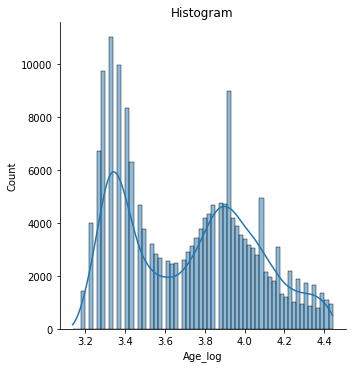

<Figure size 720x432 with 0 Axes>

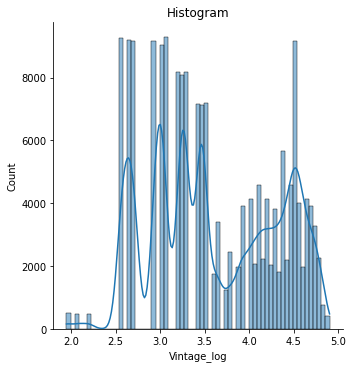

<Figure size 720x432 with 0 Axes>

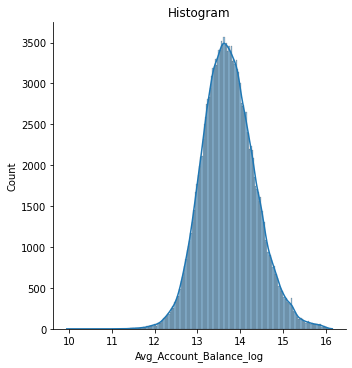

In [11]:
#Distribution of the numeric variables
dis_col=['Age_log','Vintage_log','Avg_Account_Balance_log']
for n in dis_col:
    histogram(X_train[n])

In [12]:
#Drop the unnecesary variables
#data=data.drop(['Age','Vintage','Avg_Account_Balance'],axis=1)
X_train=X_train.drop(['Age','Vintage','Avg_Account_Balance'],axis=1)
X_valid=X_valid.drop(['Age','Vintage','Avg_Account_Balance'],axis=1)
test=test.drop(['Age','Vintage','Avg_Account_Balance'],axis=1)

In [145]:
print(test.columns)

Index(['Gender', 'Region_Code', 'Occupation', 'Channel_Code', 'Credit_Product',
       'Is_Active', 'Age_log', 'Vintage_log', 'Avg_Account_Balance_log'],
      dtype='object')


In [14]:
#Preprocessing for categorical variables
from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import LabelEncoder

#data=data.dropna().reset_index(drop = True)

for c in cat_cols:
    im_c=SimpleImputer(strategy='constant',fill_value='na')
    #data[c]=im_c.fit_transform(data[[c]])
    X_train[c]=im_c.fit_transform(X_train[[c]])
    X_valid[c]=im_c.transform(X_valid[[c]])
    test[c]=im_c.transform(test[[c]])

cat=train.select_dtypes(exclude=[np.number]).columns
cats=[ c for c in cat if c not in ['Region_Code']]
for c in cats:
    oe=LabelEncoder()
    #data[c]=oe.fit_transform(data[[c]])
    X_train[c]=oe.fit_transform(X_train[[c]])
    X_valid[c]=oe.transform(X_valid[[c]])
    test[c]=oe.transform(test[[c]])

#Let us Frequency Encode the Region_Code variable
Dict=X_train['Region_Code'].value_counts(normalize=True).to_dict()
X_train['Region_Code'] = X_train['Region_Code'].map(Dict)
Dict=X_valid['Region_Code'].value_counts(normalize=True).to_dict()
X_valid['Region_Code'] = X_valid['Region_Code'].map(Dict)
Dict= test['Region_Code'].value_counts(normalize=True).to_dict()
test['Region_Code'] = test['Region_Code'].map(Dict)

In [15]:
#print(data.isna().sum()/len(data))
print(X_train.isna().sum()/len(X_train))
print(test.isna().sum()/len(test))

Gender                     0.0
Region_Code                0.0
Occupation                 0.0
Channel_Code               0.0
Credit_Product             0.0
Is_Active                  0.0
Age_log                    0.0
Vintage_log                0.0
Avg_Account_Balance_log    0.0
dtype: float64
Gender                     0.0
Region_Code                0.0
Occupation                 0.0
Channel_Code               0.0
Credit_Product             0.0
Is_Active                  0.0
Age_log                    0.0
Vintage_log                0.0
Avg_Account_Balance_log    0.0
dtype: float64


In [16]:
print(X_train.dtypes)
print(X_valid.columns)
#print(test.dtypes)
print(test.head(n=6))

Gender                       int64
Region_Code                float64
Occupation                   int64
Channel_Code                 int64
Credit_Product               int64
Is_Active                    int64
Age_log                    float64
Vintage_log                float64
Avg_Account_Balance_log    float64
dtype: object
Index(['Gender', 'Region_Code', 'Occupation', 'Channel_Code', 'Credit_Product',
       'Is_Active', 'Age_log', 'Vintage_log', 'Avg_Account_Balance_log'],
      dtype='object')
          Gender  Region_Code  ...  Vintage_log  Avg_Account_Balance_log
ID                             ...                                      
VBENBARO       1     0.111450  ...     3.218876                13.517598
CCMEWNKY       1     0.143621  ...     3.891820                13.738129
VK3KGA9M       1     0.032665  ...     2.639057                12.282798
TT8RPZVC       1     0.022201  ...     3.496508                13.674028
SHQZEYTZ       0     0.032665  ...     2.944439          

In [17]:
X_valid.to_csv('X_valid_1.csv',header=True,index=False)
y_valid.to_csv('y_valid_1.csv',header=True,index=False)
test.to_csv('test_1.csv',header=True,index=False)

All the missing values are gone. Also there is no data leakage. In general we'd need to convert categorical features to vectors which we have done here.

***Perform SMOTE for resampling***

<class 'numpy.ndarray'>


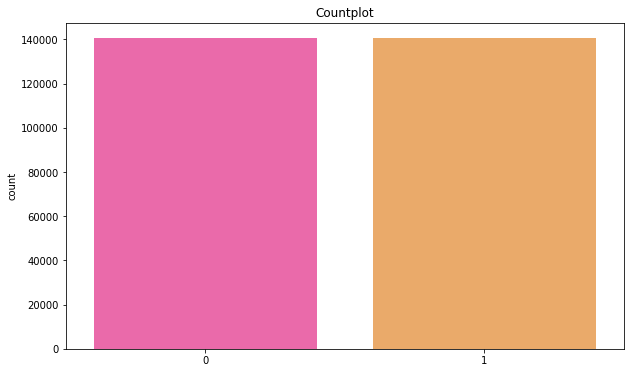

(281154, 9)


In [19]:
from imblearn.over_sampling import SMOTENC
smt=SMOTENC(categorical_features=[0,1,2,3,4,5],random_state=99)
X_res,y_res=smt.fit_resample(X_train,y_train)
print(type(X_res))
countplot(y_res)
print(X_res.shape)

In [ ]:
print(X_res)

In [20]:
coll=[x for x in X_train.columns]
print(coll)

['Gender', 'Region_Code', 'Occupation', 'Channel_Code', 'Credit_Product', 'Is_Active', 'Age_log', 'Vintage_log', 'Avg_Account_Balance_log']


In [21]:
X_res_tf=pd.DataFrame(X_res,columns=['Gender', 'Region_Code', 'Occupation', 'Channel_Code', 'Credit_Product', 'Is_Active', 'Age_log', 'Vintage_log', 'Avg_Account_Balance_log'])
X_res_tf.to_csv('X_res_tf_1.csv',header=True,index=False)

In [22]:
y_res_tf=pd.DataFrame(y_res,columns=['Is_Lead'])
y_res_tf.to_csv('y_res_tf_1.csv',header=True,index=False)

In [23]:
print(X_res_tf.shape)
print(y_res_tf.shape)

(281154, 9)
(281154, 1)


***Load the datasets after downloading when kernel is restarted***

In [4]:
X_res_df=pd.read_csv('/content/drive/MyDrive/Data/Jobathon2/X_res_tf_1.csv')
y_res_df=pd.read_csv('/content/drive/MyDrive/Data/Jobathon2/y_res_tf_1.csv')
X_valid=pd.read_csv('/content/drive/MyDrive/Data/Jobathon2/X_valid_1.csv')
y_valid=pd.read_csv('/content/drive/MyDrive/Data/Jobathon2/y_valid_1.csv')
test=pd.read_csv('/content/drive/MyDrive/Data/Jobathon2/test_1.csv')

In [5]:
print(X_res_df.shape)
print(y_res_df.shape)
print(X_valid.isna().sum())
print(test.isna().sum())

(281154, 9)
(281154, 1)
Gender                     0
Region_Code                0
Occupation                 0
Channel_Code               0
Credit_Product             0
Is_Active                  0
Age_log                    0
Vintage_log                0
Avg_Account_Balance_log    0
dtype: int64
Gender                     0
Region_Code                0
Occupation                 0
Channel_Code               0
Credit_Product             0
Is_Active                  0
Age_log                    0
Vintage_log                0
Avg_Account_Balance_log    0
dtype: int64


***Modeling using catBoostClassifier***

In [7]:
pip install catboost

     |████████████████████████████████| 67.3MB 45kB/s 


In [8]:
from catboost import CatBoostClassifier,Pool,cv
import timeit


new_cat_col=X_res_df.select_dtypes(exclude=[np.number]).columns
new_cat_cols=[c for c in new_cat_col]

cat_features = [X_res_df.columns.get_loc(col) for col in new_cat_cols]
print(cat_features)

train_x=Pool(data=X_res_df,label=y_res_df,cat_features=cat_features)
valid_x=Pool(data=X_valid,label=y_valid,cat_features=cat_features)
test_x=Pool(data=test,cat_features=cat_features)

def train_on_gpu(): 
  params = {'loss_function':'Logloss',
          'learning_rate':0.003,
          'depth':4,
          'l2_leaf_reg': 10.12,
          'n_estimators':100000,
          'eval_metric':'AUC',
          'od_type': 'Iter',
          'od_wait':1000,
          'verbose':200,
          'one_hot_max_size':0,
          #'class_weights':(1,3.21),
          'random_state':99,
          'task_type':'GPU'} 
  cb=CatBoostClassifier(**params)
  
  cb.fit(train_x,eval_set=valid_x,use_best_model=True,plot=True)
  pred=cb.predict_proba(test_x)[:,1]
  pred_df=pd.DataFrame(pred,columns=['Is_Lead'])
  print(pred_df.head(n=6))
  submission=pd.concat([sub['ID'],pred_df['Is_Lead']],axis=1)
  submission.to_csv('submission_cat.csv',header=True,index=False)
  files.download("submission_cat.csv");     
      
gpu_time = timeit.timeit('train_on_gpu()', 
                         setup="from __main__ import train_on_gpu", 
                         number=1)

[]


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.8567791	test: 0.8550964	best: 0.8550964 (0)	total: 14.9ms	remaining: 24m 53s
200:	learn: 0.8628603	test: 0.8605535	best: 0.8605535 (200)	total: 2.11s	remaining: 17m 27s
400:	learn: 0.8727605	test: 0.8627834	best: 0.8628543 (393)	total: 4.07s	remaining: 16m 52s
600:	learn: 0.8776931	test: 0.8644128	best: 0.8644128 (600)	total: 6.05s	remaining: 16m 40s
800:	learn: 0.8833261	test: 0.8662917	best: 0.8662952 (799)	total: 8.01s	remaining: 16m 31s
1000:	learn: 0.8881781	test: 0.8669988	best: 0.8669988 (1000)	total: 10s	remaining: 16m 33s
1200:	learn: 0.8922849	test: 0.8674293	best: 0.8674293 (1200)	total: 12.1s	remaining: 16m 31s
1400:	learn: 0.8967104	test: 0.8679262	best: 0.8679262 (1400)	total: 14s	remaining: 16m 27s
1600:	learn: 0.9013091	test: 0.8686220	best: 0.8686220 (1600)	total: 16.1s	remaining: 16m 27s
1800:	learn: 0.9052633	test: 0.8690619	best: 0.8690626 (1799)	total: 18.2s	remaining: 16m 31s
2000:	learn: 0.9085834	test: 0.8694975	best: 0.8694988 (1999)	total: 20.4s	re

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

***Modeling using XGBoost***

In [9]:
import xgboost as xgb
#train_data=xgb.DMatrix(data=X_res_tf,label=y_res_tf)
#valid_data=xgb.DMatrix(data=X_valid,label=y_valid)
#test_data=xgb.DMatrix(data=test)

In [10]:
#Define the parameters and perform xgboost classifier
params={'objective':'binary:logistic',
        'booster':'gbtree',
        'n_estimators':100000,
        'learning_rate':0.001,
        'gamma': 5,
        'max_depth': 8,
        'lambda': 4,
        #'scale_pos_weight':3.22,
        'random_state':99}
xg_c=xgb.XGBClassifier(**params)
xg_c.fit(X_res_df,y_res_df,eval_set=[(X_valid,y_valid)],eval_metric=['auc'],early_stopping_rounds=1000)

[0]	validation_0-auc:0.86104
Will train until validation_0-auc hasn't improved in 1000 rounds.
[1]	validation_0-auc:0.861042
[2]	validation_0-auc:0.860768
[3]	validation_0-auc:0.860842
[4]	validation_0-auc:0.86078
[5]	validation_0-auc:0.860752
[6]	validation_0-auc:0.860769
[7]	validation_0-auc:0.860762
[8]	validation_0-auc:0.86075
[9]	validation_0-auc:0.86073
[10]	validation_0-auc:0.860836
[11]	validation_0-auc:0.860822
[12]	validation_0-auc:0.860847
[13]	validation_0-auc:0.860857
[14]	validation_0-auc:0.860838
[15]	validation_0-auc:0.860938
[16]	validation_0-auc:0.860989
[17]	validation_0-auc:0.860892
[18]	validation_0-auc:0.860928
[19]	validation_0-auc:0.860933
[20]	validation_0-auc:0.860898
[21]	validation_0-auc:0.860958
[22]	validation_0-auc:0.860943
[23]	validation_0-auc:0.860938
[24]	validation_0-auc:0.860995
[25]	validation_0-auc:0.861004
[26]	validation_0-auc:0.861024
[27]	validation_0-auc:0.861025
[28]	validation_0-auc:0.861024
[29]	validation_0-auc:0.861029
[30]	validation_0-

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=5, lambda=4,
              learning_rate=0.001, max_delta_step=0, max_depth=8,
              min_child_weight=1, missing=None, n_estimators=100000, n_jobs=1,
              nthread=None, objective='binary:logistic', random_state=99,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
              silent=None, subsample=1, verbosity=1)

In [11]:
pred_xgb=xg_c.predict_proba(test)[:,1]
pred_df=pd.DataFrame(pred_xgb,columns=['Is_Lead'])
submission=pd.concat([sub['ID'],pred_df['Is_Lead']],axis=1)
submission.to_csv('submission_xgb.csv',header=True,index=False)
files.download("submission_xgb.csv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

***Modeling using LightGBM***



In [12]:
# build the lightgbm model
import lightgbm as lgb
import lightgbm
params={'n_estimators':100000,
        'boosting_type':'gbdt',
        'learning_rate': .003,
        #'scale_pos_weight':3.22,
        'min_data_in_leaf': 100,
        'max_bin': 94,
        'num_leaves': 10, 
        'max_depth': 27, 
        'reg_alpha': 8.457, 
        'reg_lambda': 6.853, 
        'subsample': 0.749}
callback=lightgbm.early_stopping(1000,verbose=True)
lgb = lgb.LGBMClassifier(**params)
lgb.fit(X_res_df,y_res_df,eval_set=[(X_valid,y_valid)],eval_metric='auc',early_stopping_rounds=1000)

[1]	valid_0's binary_logloss: 0.691897	valid_0's auc: 0.85662
Training until validation scores don't improve for 1000 rounds.
[2]	valid_0's binary_logloss: 0.690653	valid_0's auc: 0.85662
[3]	valid_0's binary_logloss: 0.689417	valid_0's auc: 0.85662
[4]	valid_0's binary_logloss: 0.688188	valid_0's auc: 0.85662
[5]	valid_0's binary_logloss: 0.686967	valid_0's auc: 0.85662
[6]	valid_0's binary_logloss: 0.685752	valid_0's auc: 0.85662
[7]	valid_0's binary_logloss: 0.684544	valid_0's auc: 0.85662
[8]	valid_0's binary_logloss: 0.683343	valid_0's auc: 0.85662
[9]	valid_0's binary_logloss: 0.682149	valid_0's auc: 0.85662
[10]	valid_0's binary_logloss: 0.680961	valid_0's auc: 0.85662
[11]	valid_0's binary_logloss: 0.679781	valid_0's auc: 0.85662
[12]	valid_0's binary_logloss: 0.678607	valid_0's auc: 0.85662
[13]	valid_0's binary_logloss: 0.67744	valid_0's auc: 0.85662
[14]	valid_0's binary_logloss: 0.676279	valid_0's auc: 0.85662
[15]	valid_0's binary_logloss: 0.675125	valid_0's auc: 0.85662
[

LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.003, max_bin=94,
               max_depth=27, min_child_samples=20, min_child_weight=0.001,
               min_data_in_leaf=100, min_split_gain=0.0, n_estimators=100000,
               n_jobs=-1, num_leaves=10, objective=None, random_state=None,
               reg_alpha=8.457, reg_lambda=6.853, silent=True, subsample=0.749,
               subsample_for_bin=200000, subsample_freq=0)

In [13]:
# build the lightgbm model
import lightgbm as lgb
import lightgbm
params={'n_estimators':100000,
        'boosting_type':'gbdt',
        'learning_rate': .003,
        #'scale_pos_weight':3.22,
        'min_data_in_leaf': 100,
        'max_bin': 94,
        'num_leaves': 10, 
        'max_depth': 7, 
        'reg_alpha': 8.457, 
        'reg_lambda': 6.853, 
        'subsample': 0.749}
callback=lightgbm.early_stopping(1000,verbose=True)
lgb = lgb.LGBMClassifier(**params)
lgb.fit(X_res_df,y_res_df,eval_set=[(X_valid,y_valid)],eval_metric='auc',early_stopping_rounds=1000)

Streaming output truncated to the last 5000 lines.
[468]	valid_0's binary_logloss: 0.469326	valid_0's auc: 0.863187
[469]	valid_0's binary_logloss: 0.469187	valid_0's auc: 0.863193
[470]	valid_0's binary_logloss: 0.469052	valid_0's auc: 0.863187
[471]	valid_0's binary_logloss: 0.468915	valid_0's auc: 0.863193
[472]	valid_0's binary_logloss: 0.468779	valid_0's auc: 0.863197
[473]	valid_0's binary_logloss: 0.468646	valid_0's auc: 0.863185
[474]	valid_0's binary_logloss: 0.46851	valid_0's auc: 0.863194
[475]	valid_0's binary_logloss: 0.468378	valid_0's auc: 0.863195
[476]	valid_0's binary_logloss: 0.468245	valid_0's auc: 0.863199
[477]	valid_0's binary_logloss: 0.468114	valid_0's auc: 0.863192
[478]	valid_0's binary_logloss: 0.467982	valid_0's auc: 0.863198
[479]	valid_0's binary_logloss: 0.46785	valid_0's auc: 0.863203
[480]	valid_0's binary_logloss: 0.46772	valid_0's auc: 0.863197
[481]	valid_0's binary_logloss: 0.467577	valid_0's auc: 0.863255
[482]	valid_0's binary_logloss: 0.467447	v

LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.003, max_bin=94,
               max_depth=7, min_child_samples=20, min_child_weight=0.001,
               min_data_in_leaf=100, min_split_gain=0.0, n_estimators=100000,
               n_jobs=-1, num_leaves=10, objective=None, random_state=None,
               reg_alpha=8.457, reg_lambda=6.853, silent=True, subsample=0.749,
               subsample_for_bin=200000, subsample_freq=0)

In [15]:
pred_lgb=lgb.predict_proba(test)[:,1]
pred_df=pd.DataFrame(pred_lgb,columns=['Is_Lead'])
submission=pd.concat([sub['ID'],pred_df['Is_Lead']],axis=1)
submission.to_csv('submission_lgb.csv',header=True,index=False)
files.download("submission_lgb.csv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

***Final Prediction***

In [26]:
cat=pd.read_csv('/content/drive/MyDrive/Data/Jobathon2/submission_cat.csv')
xgb=pd.read_csv('/content/drive/MyDrive/Data/Jobathon2/submission_xgb.csv')
lgb=pd.read_csv('/content/drive/MyDrive/Data/Jobathon2/submission_lgb.csv')

In [ ]:
pred_cat=cat['Is_Lead']
pred_xgb=xgb['Is_Lead']
pred_lgb=lgb['Is_Lead']

In [29]:
print(pred_cat)
print(pred_xgb)
print(pred_lgb)

0         0.070354
1         0.869661
2         0.075864
3         0.036303
4         0.033409
            ...   
105307    0.970726
105308    0.597782
105309    0.089848
105310    0.275815
105311    0.091638
Name: Is_Lead, Length: 105312, dtype: float64
0         0.175954
1         0.906020
2         0.180096
3         0.143611
4         0.134753
            ...   
105307    0.877387
105308    0.744705
105309    0.181869
105310    0.425845
105311    0.127831
Name: Is_Lead, Length: 105312, dtype: float64
0         0.105750
1         0.923838
2         0.114486
3         0.049834
4         0.037371
            ...   
105307    0.985967
105308    0.789972
105309    0.155847
105310    0.482401
105311    0.107408
Name: Is_Lead, Length: 105312, dtype: float64


In [ ]:
#Final Prediction
pred_final= (pred_cat+pred_xgb+pred_lgb)/3
pred_df=pd.DataFrame(pred_final,columns=['Is_Lead'])
submission=pd.concat([sub['ID'],pred_df['Is_Lead']],axis=1)
submission.to_csv('submission.csv',header=True,index=False)
files.download("submission.csv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>